In [2]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import spectrogram
import librosa
import IPython.display as ipd
from scipy.signal import get_window


In [3]:
# === Changeable parameters ===
file_path = 'From Ashes To New.mp3'
sampling_rate = 48000
fft_size = 4096 #points used in FFT
window_length = 4096 #samples pr segment for spectrogram
overlap_size = window_length // 2 #how much overlap
use_db_scaling = True #enable / disable dB-scaling


In [4]:
# === LOAD AUDIO ===
audio_data, sampling_rate = librosa.load(file_path, sr=None) #Loads the audio
if audio_data.ndim == 2:
    audio_data = audio_data.mean(axis=1) #If the audio signal is sterio, it gets converted to mono
audio_data = audio_data / np.max(np.abs(audio_data)) #Normalizing the data

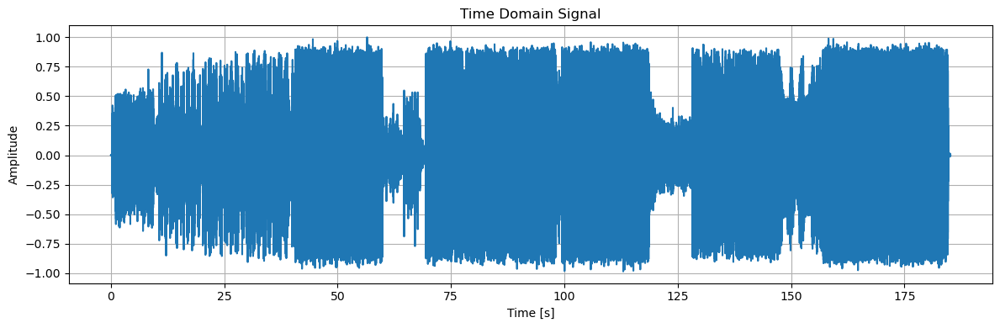

In [5]:
# === TIME DOMAIN PLOT ===
duration_in_seconds = len(audio_data) / sampling_rate #Compute the duration in seconds
time_axis = np.linspace(0, duration_in_seconds, len(audio_data)) #Makes sure the time value are evenly spaced

plt.figure(figsize=(12, 4))
plt.plot(time_axis, audio_data)
plt.title("Time Domain Signal")
plt.xlabel("Time [s]")
plt.ylabel("Amplitude")
plt.grid(True)
plt.tight_layout()
plt.show()

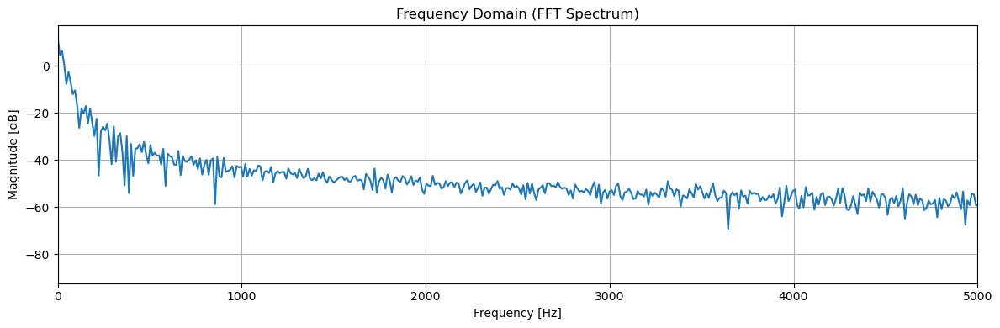

In [12]:
# FFT
fft_result = np.fft.fft(audio_data, n=fft_size) #Uses numpy library to compute the FFT result
magnitude_spectrum = np.abs(fft_result)[:fft_size // 2] #Extracts only the positive results from FFT
if use_db_scaling:
    magnitude_spectrum = 20 * np.log10(magnitude_spectrum + 1e-10) #Uses the FFT results to compute the level of dB

frequency_axis = np.fft.fftfreq(fft_size, d=1 / sampling_rate)[:fft_size // 2] #Defines a frequency axis in Hz

plt.figure(figsize=(12, 4))
plt.plot(frequency_axis, magnitude_spectrum)
plt.xlim(0, 5000)
plt.title("Frequency Domain (FFT Spectrum)")
plt.xlabel("Frequency [Hz]")
plt.ylabel("Magnitude [{}]".format("dB" if use_db_scaling else "Linear"))
plt.grid(True)
plt.tight_layout()
plt.show()

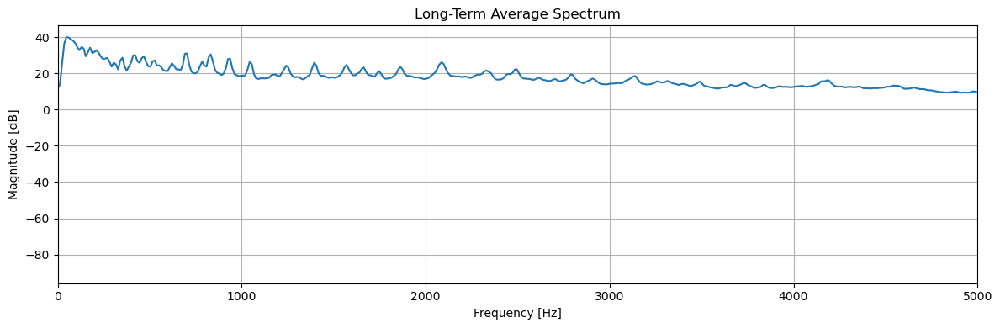

In [7]:
# Break audio into overlapping segments
step_size = window_length - overlap_size #Defines how much the window moves
num_segments = (len(audio_data) - window_length) // step_size + 1 #Compute the number of segments needed
window = get_window('hann', window_length) #Define the window type
spectrum_accumulator = np.zeros(fft_size // 2) #A placeholder for accumulating spectral data

for i in range(num_segments): #For loop performs FFT
    start = i * step_size
    segment = audio_data[start:start + window_length] * window
    segment_fft = np.fft.fft(segment, n=fft_size)
    magnitude = np.abs(segment_fft[:fft_size // 2])
    spectrum_accumulator += magnitude

average_spectrum = spectrum_accumulator / num_segments #Compute the average magnitude spectrum
if use_db_scaling: #Checks if dB-scale is on
    average_spectrum = 20 * np.log10(average_spectrum + 1e-10)

plt.figure(figsize=(12, 4))
plt.plot(frequency_axis, average_spectrum)
plt.xlim(0, 5000)
plt.title("Long-Term Average Spectrum")
plt.xlabel("Frequency [Hz]")
plt.ylabel("Magnitude [{}]".format("dB" if use_db_scaling else "Linear"))
plt.grid(True)
plt.tight_layout()
plt.show()

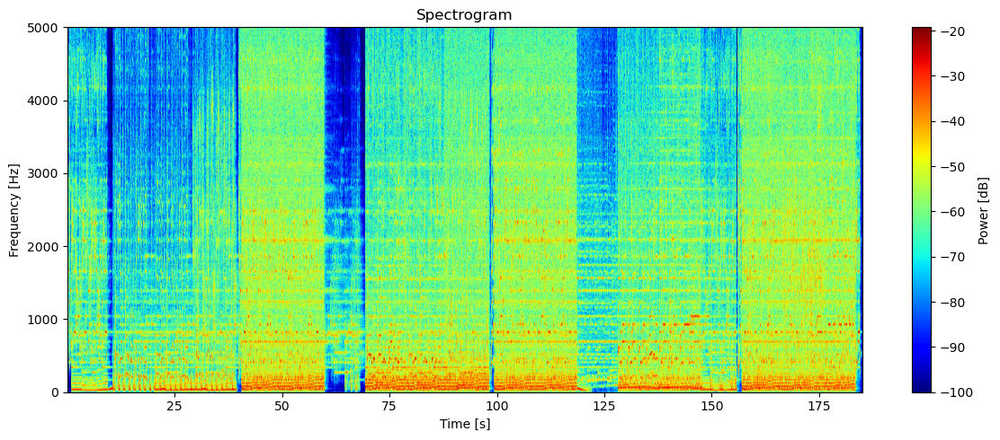

In [8]:
# SPECTROGRAM
frequencies, times, spectral_Density = spectrogram( #Defines the spectrogram
    audio_data,
    fs=sampling_rate,
    window='hann',
    nperseg=window_length,
    noverlap=overlap_size
)

if use_db_scaling: #Checks if dB-scale is on
    spectral_Density = 10 * np.log10(spectral_Density + 1e-10)

plt.figure(figsize=(12, 5))
plt.ylim(0, 5000)
plt.pcolormesh(times, frequencies, spectral_Density, shading='gouraud', cmap='jet')
plt.title("Spectrogram")
plt.xlabel("Time [s]")
plt.ylabel("Frequency [Hz]")
plt.colorbar(label='Power [{}]'.format("dB" if use_db_scaling else "Linear"))
plt.tight_layout()
plt.show()

In [9]:
# Play the audio here
ipd.Audio(audio_data, rate=sampling_rate)